# Compara nodos para saber cuál es el que presenta los mejores datos para cada valriable y qué periodo de tiempo corresponden

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import pandas as pd
import funs
import seaborn as sns
import plotly.plotly as py
from plotly.graph_objs import *
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

### Lee los nodos en un diccionario de dataframes

In [2]:
tablas={}
for nodo in [2,3,4,5,6,8]:
    tablas[nodo] = pd.read_csv('medidas_nodo%s'%nodo,parse_dates=True,index_col=0)

### Grafica los valores de las variables de cada nodo en gráficas interactivas

In [3]:
for nodo in [2,3,4,5,6,8]:
    data = ([{'x': tablas[nodo].index,'y': tablas[nodo][col],'name': col}
             for col in tablas[nodo].columns[0:4]])
    layout = dict(title = 'NODO %s' %nodo,
                  yaxis = dict(title = '°C, %RH, %Pw, Nivel UV'),
                  xaxis = dict(title = 'FECHA')
                 )
    fig = dict(data=data, layout=layout)
    iplot(fig,layout)

### Aplica funs.separa, obtine para cada nodo una lista de DF con los registros obtenidos entre periodos de medición con separación de más de t minutos

In [4]:
# Aplica la función separa_nodos, que calcula el tamaño de los dataframes entre periodos de medición con separación #edge"
t = 60 * 24
nodo, periodos = {}, {}
for i in [2,3,4,5,6,8]:
    nodo[i], periodos[i] = funs.separa_datos(tablas[i],t)

### Se obtiene la cantidad de divisiones realizadas para un nodo, el rango de los datos y su tamaño

In [5]:
periodos[2]

,inicio,fin,datos
0,2018-05-09 09:49:00,2018-05-10 14:38:00,1722
1,2018-05-23 09:23:00,2018-05-26 07:01:00,4141
2,2018-06-05 10:12:00,2018-06-09 15:24:00,5149
3,2018-06-11 08:52:00,2018-06-11 09:16:00,25


In [6]:
periodos[3]

,inicio,fin,datos
0,2018-05-09 09:50:00,2018-05-10 14:38:00,1710
1,2018-05-23 10:01:00,2018-05-28 22:32:00,7930
2,2018-06-05 10:16:00,2018-06-08 18:40:00,4698
3,2018-06-11 08:57:00,2018-06-11 09:16:00,20


In [7]:
periodos[4]

,inicio,fin,datos
0,2018-05-09 10:36:00,2018-05-09 14:06:00,186
1,2018-05-23 10:47:00,2018-05-24 10:16:00,205


In [8]:
periodos[5]

,inicio,fin,datos
0,2018-05-09 10:26:00,2018-05-10 14:37:00,1673
1,2018-05-23 10:09:00,2018-05-26 08:34:00,4202
2,2018-06-05 10:22:00,2018-06-11 09:16:00,5892


In [9]:
periodos[6]

,inicio,fin,datos
0,2018-05-09 09:49:00,2018-05-10 14:38:00,1619
1,2018-05-23 09:44:00,2018-05-23 10:37:00,47


In [10]:
periodos[8]

,inicio,fin,datos
0,2018-05-24 09:42:00,2018-05-29 07:35:00,6438
1,2018-06-05 10:37:00,2018-06-09 16:32:00,1922
2,2018-06-10 18:02:00,2018-06-11 09:17:00,76


### Grafica el periodo de medicición escogido

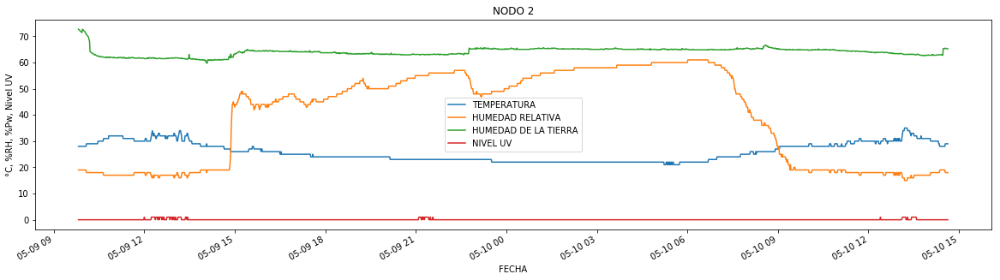

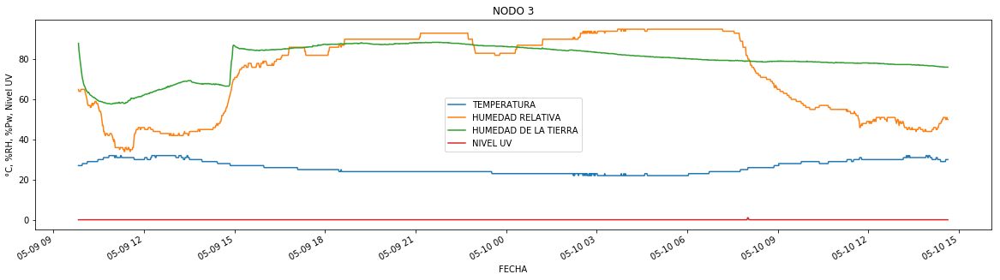

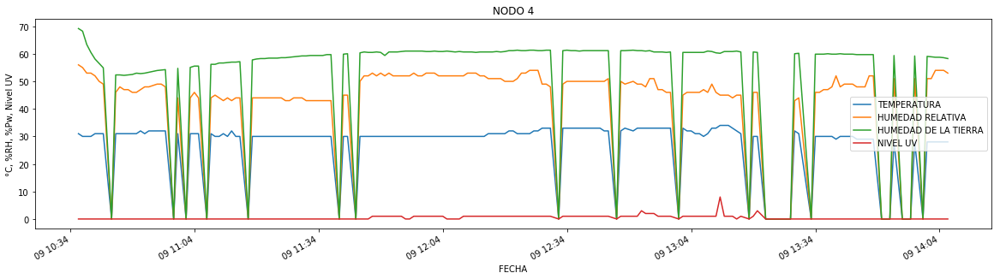

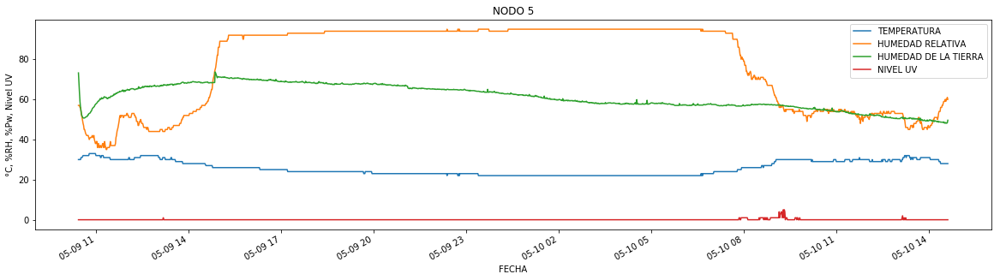

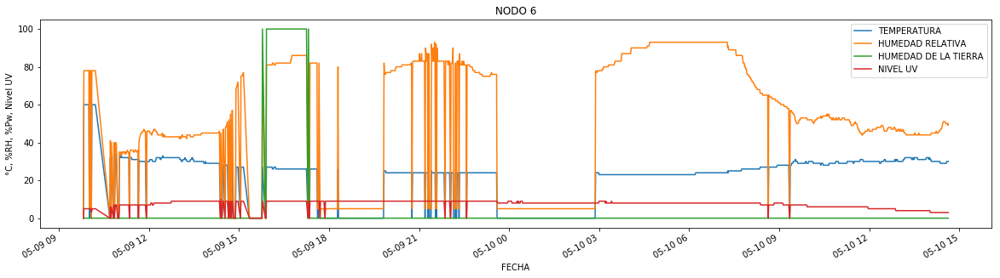

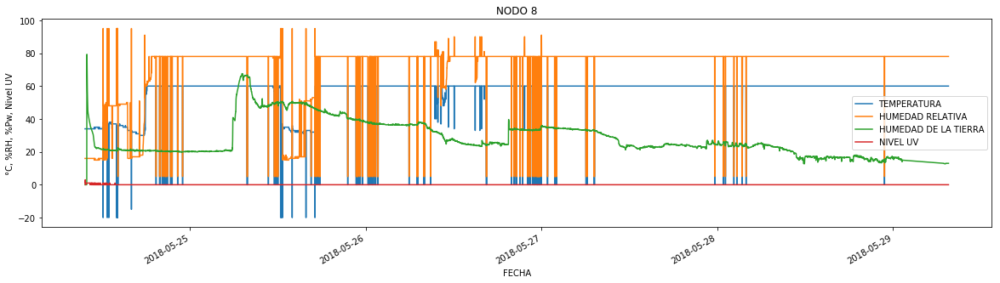

In [11]:
T = 0
for i in [2,3,4,5,6,8]:
    nodo[i][T].iloc[:,0:4].plot(figsize=[20,5])
    plt.title('NODO %s'%i)
    plt.xlabel('FECHA')
    plt.ylabel('°C, %RH, %Pw, Nivel UV')
    # Nodos que presentan mediciones por más de un día con comportamiento similar al obervado en 
    # otros nodos
    #primer periodo nodos 2, 3 y 5
    # Segundo periodo nodos 2, 3 y 5
    # Tercer periodo 2, 3 y 5
    # Cuarto periodo: ninguno

In [12]:
periodos[2][1:3]

,inicio,fin,datos
1,2018-05-23 09:23:00,2018-05-26 07:01:00,4141
2,2018-06-05 10:12:00,2018-06-09 15:24:00,5149


In [13]:
periodos[3][1:3]

,inicio,fin,datos
1,2018-05-23 10:01:00,2018-05-28 22:32:00,7930
2,2018-06-05 10:16:00,2018-06-08 18:40:00,4698


In [14]:
periodos[5][1:3]

,inicio,fin,datos
1,2018-05-23 10:09:00,2018-05-26 08:34:00,4202
2,2018-06-05 10:22:00,2018-06-11 09:16:00,5892


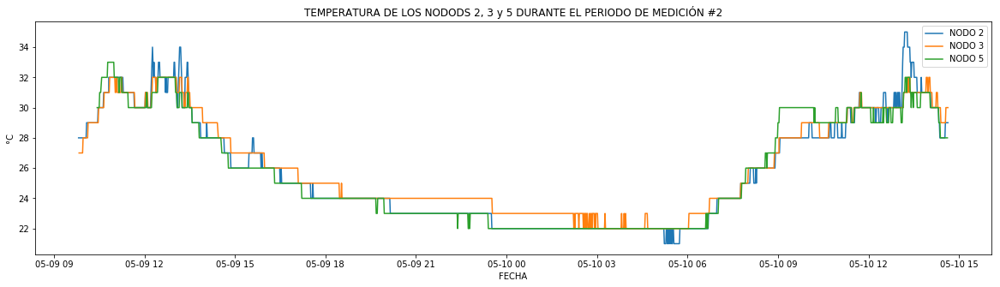

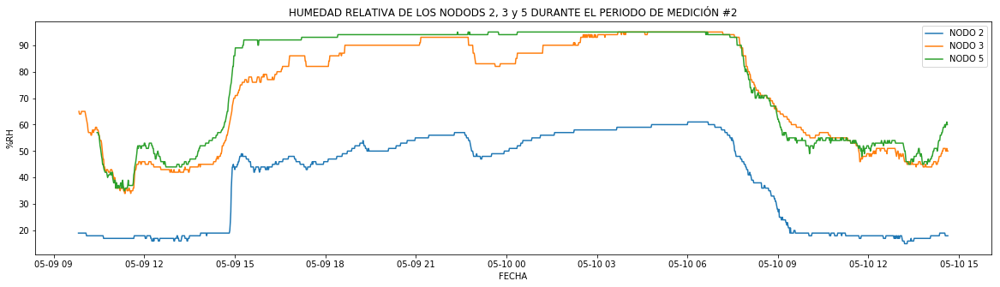

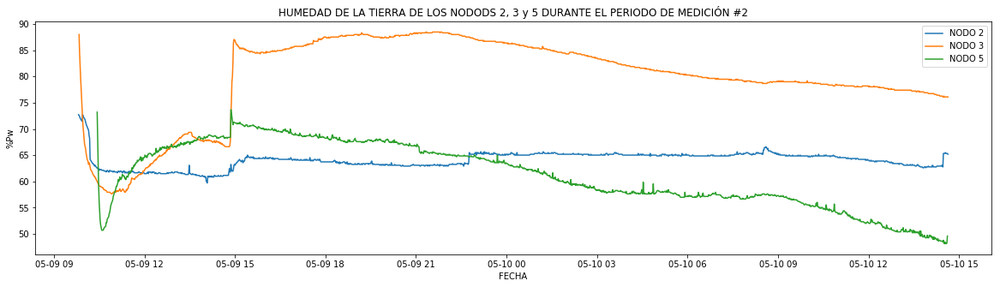

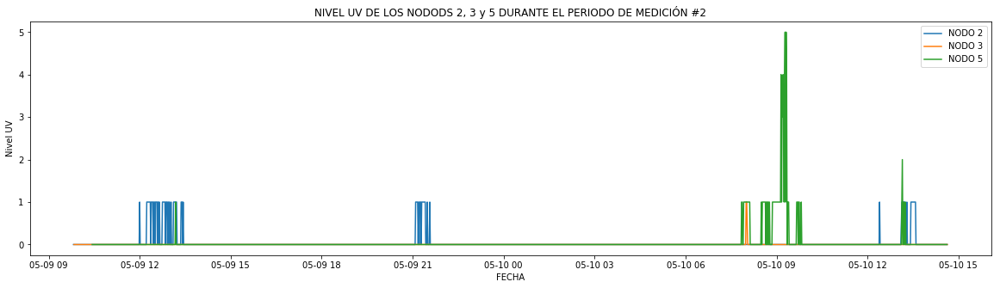

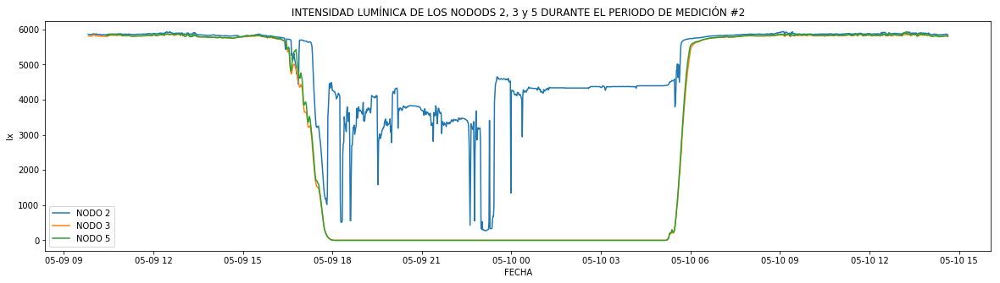

In [32]:
# Presenta los registros del segundo periodo de medición de los nodos 2, 3 y 5 
T = 1
mag = {0:'°C', 1:'%RH', 2:'%Pw', 3:'Nivel UV', 4:'lx'}
for i in range(5):
    plt.figure(figsize=[20,5])
    plt.title('%s DE LOS NODODS 2, 3 y 5 DURANTE EL PERIODO DE MEDICIÓN #%d'%(nodo[2][0].columns[i],T+1))
    plt.xlabel('FECHA')
    plt.ylabel(mag[i])
    plt.plot(nodo[2][0].iloc[:,i],label='NODO 2')
    plt.plot(nodo[3][0].iloc[:,i],label='NODO 3')
    plt.plot(nodo[5][0].iloc[:,i],label='NODO 5')
    plt.legend()

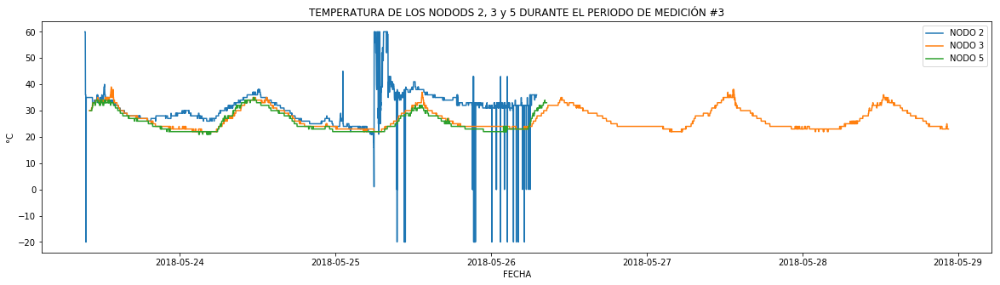

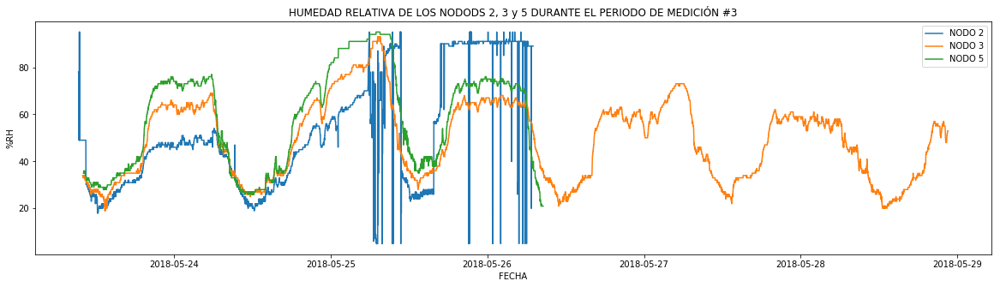

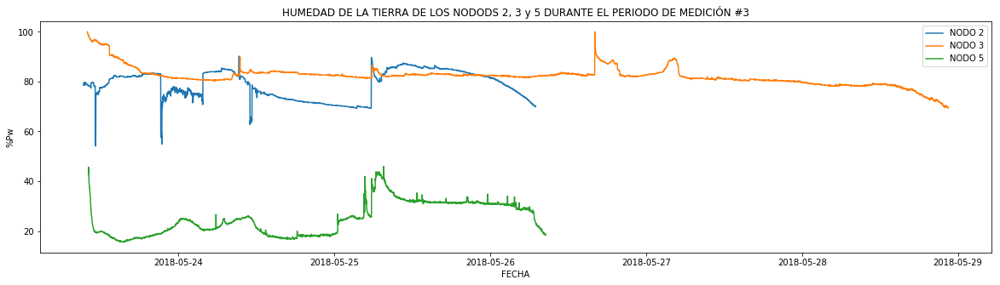

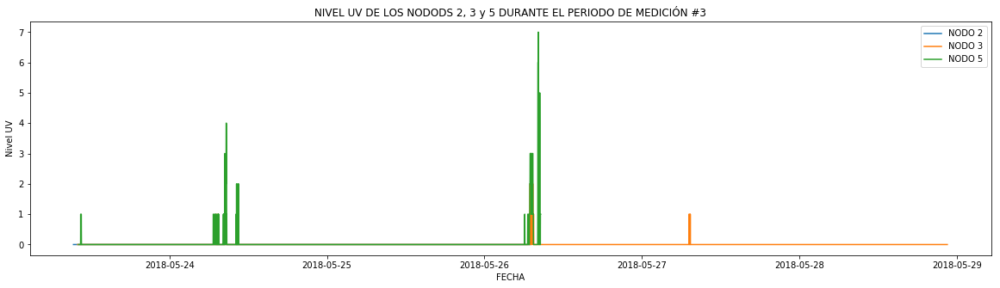

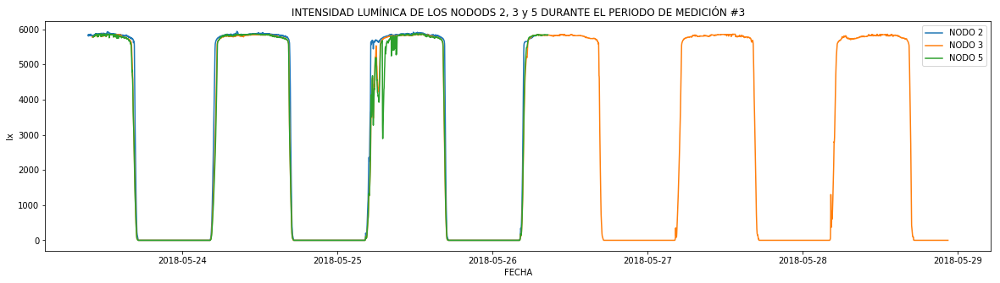

In [33]:
# Presenta los registros del tercer periodo de los nodos 2, 3 y 5 
T = 2
mag = {0:'°C', 1:'%RH', 2:'%Pw', 3:'Nivel UV', 4:'lx'}
for i in range(5):
    plt.figure(figsize=[20,5])
    plt.title('%s DE LOS NODODS 2, 3 y 5 DURANTE EL PERIODO DE MEDICIÓN #%d'%(nodo[2][0].columns[i],T+1))
    plt.xlabel('FECHA')
    plt.ylabel(mag[i])
    plt.plot(nodo[2][1].iloc[:,i],label='NODO 2')
    plt.plot(nodo[3][1].iloc[:,i],label='NODO 3')
    plt.plot(nodo[5][1].iloc[:,i],label='NODO 5')
    plt.legend()